# Animations

## Requirements

If you want to create animations in `mp4` format, you need `ffmpeg` installed on your system. See [Troubleshoot](https://kausable.github.io/CausalDynamics/troubleshoot.html). However, you can create `.gif` files out of the box.

## Generate data and create an animation
Let's look at how to create an animation. For this we first create a small example system.

INFO - Creating SCM with 5 nodes and 3 dimensions each...
INFO - Simulating random system for 200 timesteps...
/Users/herdeanu/kausable/causaldynamics/.venv/lib/python3.10/site-packages/dysts/base.py:353: UserWarning: This system has at least one unbounded variable, which has been mapped to a bounded domain. Pass argument postprocess=False in order to generate trajectories from the raw system.
  warnings.warn(


(<Axes3D: title={'center': 'Node 0'}, xlabel='X', ylabel='Y', zlabel='Z'>,
 <Axes3D: title={'center': 'Root node 1'}, xlabel='X', ylabel='Y', zlabel='Z'>,
 <Axes3D: title={'center': 'Node 2'}, xlabel='X', ylabel='Y', zlabel='Z'>,
 <Axes3D: title={'center': 'Root node 3'}, xlabel='X', ylabel='Y', zlabel='Z'>,
 <Axes3D: title={'center': 'Root node 4'}, xlabel='X', ylabel='Y', zlabel='Z'>)

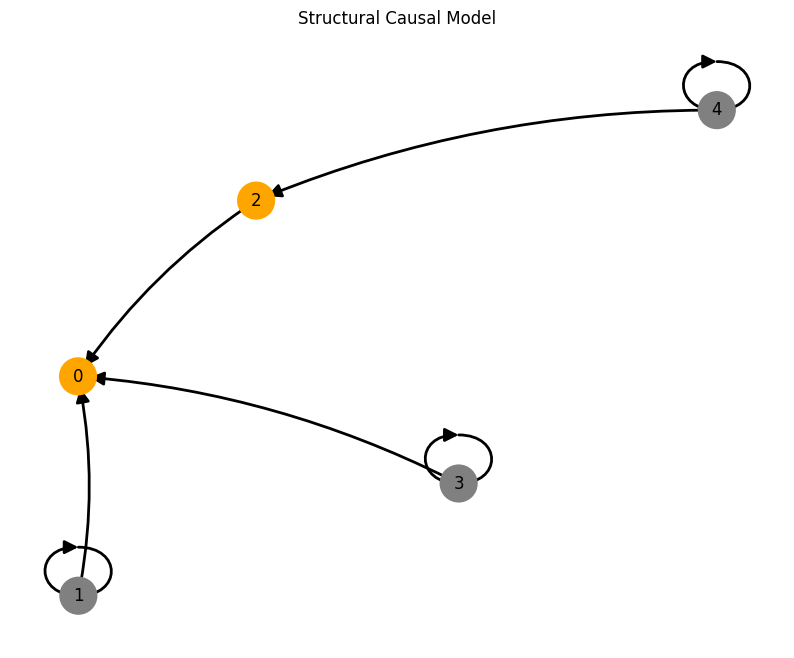

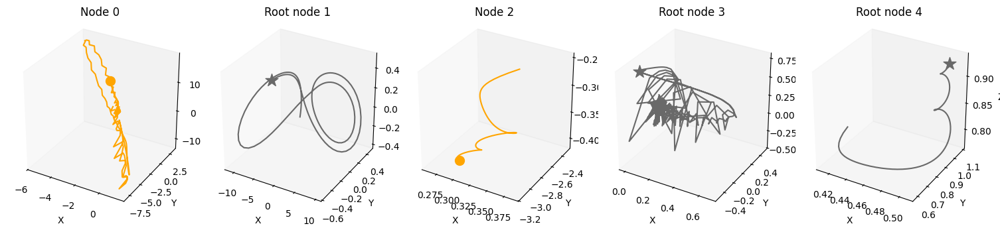

In [3]:
from causaldynamics.scm import create_scm_graph
from causaldynamics.creator import create_scm, simulate_system
from causaldynamics.plot import plot_scm, plot_3d_trajectories

# Define parameters
num_nodes = 5
node_dim = 3
num_timesteps = 200

system_name='random'
confounders = False

# Create the coupled structural causal model
A, W, b, root_nodes, _ = create_scm(num_nodes, node_dim, confounders=confounders)

# Simulate the system
data = simulate_system(A, W, b, 
                      num_timesteps=num_timesteps, 
                      num_nodes=num_nodes,
                      system_name=system_name) 

# Visualize the SCM and the system
plot_scm(G=create_scm_graph(A), root_nodes=root_nodes)
plot_3d_trajectories(data, root_nodes)

Now, we create the animation. Beware, that this takes some time to calculate...

In [4]:
from causaldynamics.plot import animate_3d_trajectories
import matplotlib as mpl

# Creating an animation of the trajectories. 
# This may take a while to run...
mpl.rcParams["animation.embed_limit"] = 50 * 1024**2  # Increase the memory limit to 50MB

animate_3d_trajectories(data, 
                        root_nodes=root_nodes, 
                        plot_type="subplots",
                        frame_skip=2, 
                        rotation_speed=0.2, 
                        rotate=True, 
                        show_history=True, 
                        save_path=None, 
                        return_html_anim=True, # perfect for use in notebooks :)
                        show_plot=False,
                        root_node_alpha=0.5,
                        node_alpha=0.5,
                        linewidth=1.5)

INFO - Animation.save using <class 'matplotlib.animation.HTMLWriter'>
